In [909]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math


from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from scipy.stats import randint
from sklearn.metrics import accuracy_score, precision_score, classification_report, plot_confusion_matrix, roc_curve, auc
import plotly.offline as pyo
import plotly. graph_objs as go
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score

import warnings 
warnings.filterwarnings('ignore')

ModuleNotFoundError: No module named 'xgboost'

In [ ]:
df = pd.read_csv(r'C:/Users/AVTJUV744/Documents/Prosthetic_Systems.csv')
df

In [ ]:
df.info()

**Imputing missing values and correcting datatypes**

In [910]:
#Imputing the missing values with median and coverting to int data type as family members will always be in int type
missing_col = ['Family members']
for i in missing_col:
    df.loc[df.loc[:,i].isnull(),i]=round(df.loc[:,i].median())

In [911]:
df['Family members'].value_counts()

1.0    1464
2.0    1310
4.0    1217
3.0    1009
Name: Family members, dtype: int64

In [912]:
#Checking for value counts in all columns
for i in df.columns:
    print(df[i].value_counts())

2049    1
1210    1
3271    1
1222    1
3267    1
1218    1
3263    1
1214    1
3259    1
3255    1
3275    1
1206    1
3251    1
1202    1
3247    1
1198    1
3243    1
1194    1
1226    1
1230    1
3471    1
1250    1
3311    1
1262    1
3307    1
1258    1
3303    1
1254    1
3299    1
3295    1
3279    1
1246    1
3291    1
1242    1
3287    1
1238    1
3283    1
1234    1
3239    1
1190    1
3235    1
3179    1
1146    1
3191    1
1142    1
3187    1
1138    1
3183    1
1134    1
1130    1
1186    1
3175    1
1126    1
3171    1
1122    1
3167    1
1118    1
3163    1
3195    1
1150    1
3199    1
1154    1
3231    1
1182    1
3227    1
1178    1
3223    1
1174    1
3219    1
1170    1
3215    1
1166    1
3211    1
1162    1
3207    1
1158    1
3203    1
1266    1
3315    1
1270    1
3415    1
1382    1
3427    1
1378    1
3423    1
1374    1
3419    1
1370    1
1366    1
3395    1
3411    1
1362    1
3407    1
1358    1
3403    1
1354    1
3399    1
3431    1
1386    1
3435    1


In [913]:
#Imputing the negative values with mean as age can't be negative
df.loc[df['Age (in years)']<0,'Age (in years)'] = df['Age (in years)'].mean()
df['Age (in years)'].value_counts()


35.0    151
43.0    149
52.0    145
54.0    143
58.0    143
50.0    138
41.0    136
30.0    136
56.0    135
34.0    134
39.0    133
59.0    132
57.0    132
51.0    129
45.0    127
60.0    127
46.0    127
42.0    126
55.0    125
31.0    125
40.0    125
29.0    123
62.0    123
61.0    122
44.0    121
33.0    120
32.0    120
48.0    118
49.0    115
38.0    115
47.0    113
53.0    112
63.0    108
36.0    107
37.0    106
28.0    103
27.0     91
65.0     80
64.0     78
26.0     78
25.0     53
24.0     28
66.0     24
23.0     12
67.0     12
Name: Age (in years), dtype: int64

In [914]:
#Imputing the negative values with mean as experience can't be negative
df.loc[df['Experience (in years)']<0,'Experience (in years)'] = df['Experience (in years)'].mean()
df['Experience (in years)'].value_counts()

32.0000    154
20.0000    148
9.0000     147
5.0000     146
23.0000    144
35.0000    143
25.0000    142
28.0000    138
18.0000    137
19.0000    135
26.0000    134
24.0000    131
3.0000     129
14.0000    127
16.0000    127
30.0000    126
34.0000    125
17.0000    125
27.0000    125
29.0000    124
22.0000    124
7.0000     121
15.0000    119
8.0000     119
6.0000     119
10.0000    118
13.0000    117
33.0000    117
11.0000    116
37.0000    116
36.0000    114
21.0000    113
4.0000     113
31.0000    104
12.0000    102
38.0000     88
2.0000      85
39.0000     85
1.0000      74
0.0000      66
40.0000     57
20.1046     52
41.0000     43
42.0000      8
43.0000      3
Name: Experience (in years), dtype: int64

**Corrected the values of Age, experience as some values were negative which is not possible. So imputed the values with mean**

In [915]:
df.describe()

,ID,Age (in years),Experience (in years),Income (in K/month),ZIP Code,Family members,Education,Personal Loan,Securities Account,CD Account,Online,CreditCard
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.00000,5000.000000,5000.000000,5000.000000,5000.00000,5000.000000,5000.000000
mean,2500.500000,45.338400,20.328688,73.774200,93152.503000,2.39580,1.881000,0.096000,0.104400,0.06040,0.596800,0.294000
std,1443.520003,11.463166,11.253009,46.033729,2121.852197,1.14534,0.839869,0.294621,0.305809,0.23825,0.490589,0.455637
min,1.000000,23.000000,0.000000,8.000000,9307.000000,1.00000,1.000000,0.000000,0.000000,0.00000,0.000000,0.000000
25%,1250.750000,35.000000,11.000000,39.000000,91911.000000,1.00000,1.000000,0.000000,0.000000,0.00000,0.000000,0.000000
50%,2500.500000,45.000000,20.104600,64.000000,93437.000000,2.00000,2.000000,0.000000,0.000000,0.00000,1.000000,0.000000
75%,3750.250000,55.000000,30.000000,98.000000,94608.000000,3.00000,3.000000,0.000000,0.000000,0.00000,1.000000,1.000000
max,5000.000000,67.000000,43.000000,224.000000,96651.000000,4.00000,3.000000,1.000000,1.000000,1.00000,1.000000,1.000000


**As you have seen above that there is huge difference in 75th and 100th percentile in CCAvg, Mortgage columns which means presence of outliers. Although those are continuous values so binning columns, CCavg, Mortgage. Also binning Age, experience and income columns for easy interpretability**

In [916]:
sns.boxplot(x=df['Mortgage'])
plt.show()

TypeError: Horizontal orientation requires numeric `x` variable.

In [ ]:
df['CCAvg'] = pd.qcut(df['CCAvg'],q=[0,0.4,1],
                          labels=['Average','High'])

In [ ]:
df['Mortgage'] = pd.qcut(df['Mortgage'],q=[0,0.75,1],
                          labels=['Average','High'])

In [ ]:
df['Age_grp'] = pd.cut(df['Age (in years)'], bins=np.linspace(20,70,num=5))

In [ ]:
df['Income_grp'] = pd.qcut(df['Income (in K/month)'],q=[0,0.4,0.7,1],
                          labels=['Low','Average','High'])

In [ ]:
df['Exp_grp'] = pd.cut(df['Experience (in years)'],bins=np.linspace(0,45,num=20))

In [ ]:
df.info()

### Data Imbalanced 

In [ ]:
plt.pie(df['Personal Loan'].value_counts(normalize=True)*100, labels = ['Accept','not Accept'])

In [ ]:
df_accept = df[df['Personal Loan']==1]
df_Naccept = df[df['Personal Loan']==0]

# Univariate and Bivariate analysis

In [ ]:
def plot_pie(variable):
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(16,15))

    data_0 = df_Naccept[variable].value_counts()
    labels = data_0.index
    ax1.pie(data_0, autopct='%1.1f%%',
            shadow=True, startangle=90, pctdistance=1.1, labeldistance=1.2)
    ax1.set_title('Not Accepted')
    ax1.legend(labels, loc="lower right")

    data_1 = df_accept[variable].value_counts()
    labels = data_1.index
    ax2.pie(data_1, autopct='%1.1f%%',
            shadow=True, startangle=90, pctdistance=1.1, labeldistance=1.2)
    ax2.set_title('Accepted')

    ax2.legend(labels, loc="lower right")

    plt.show()

In [ ]:
plot_pie('CCAvg')

In [ ]:
plot_pie('Mortgage')

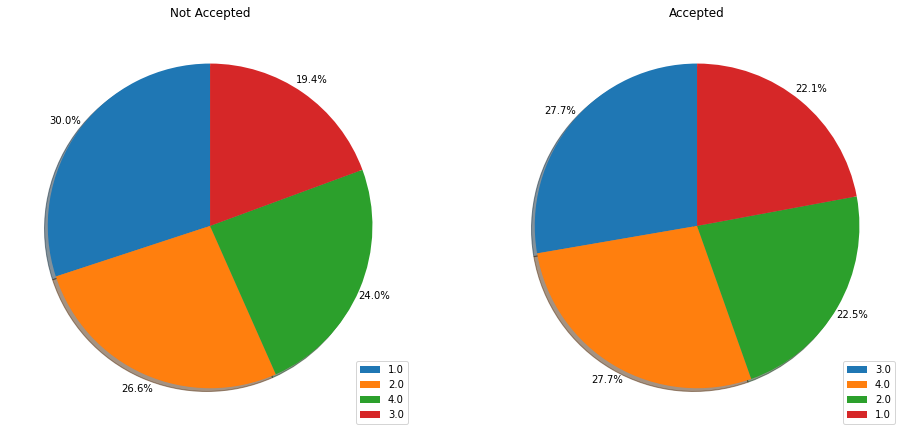

In [917]:
plot_pie('Family members')

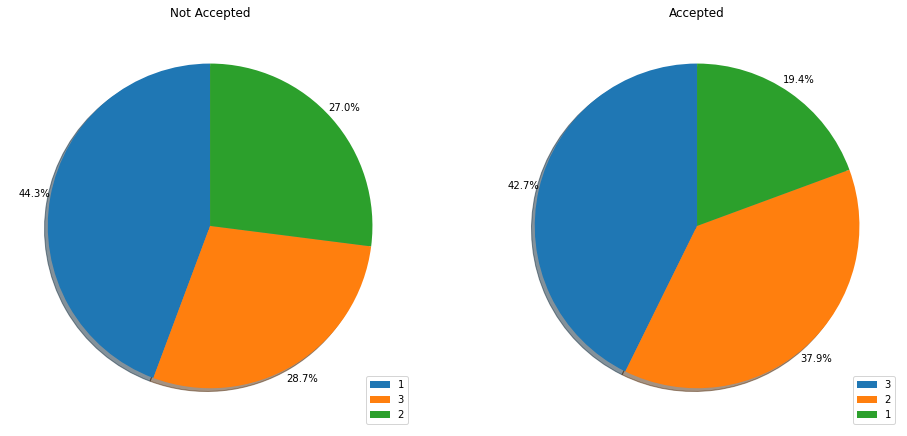

In [918]:
plot_pie('Education')

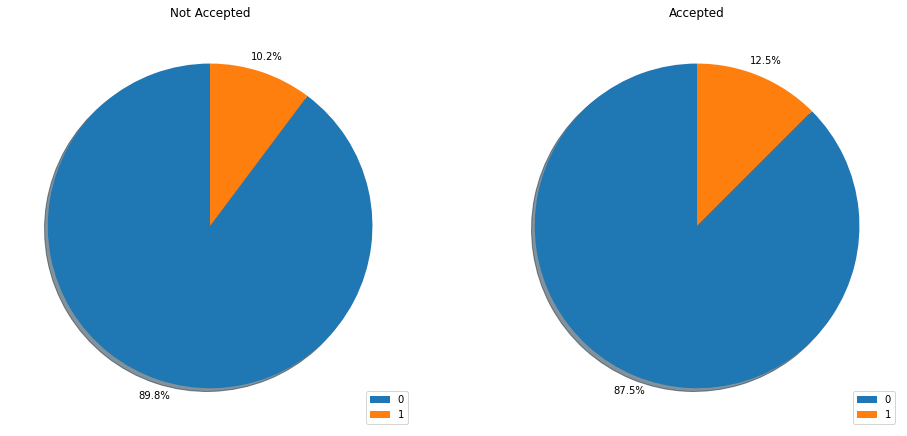

In [919]:
plot_pie('Securities Account')

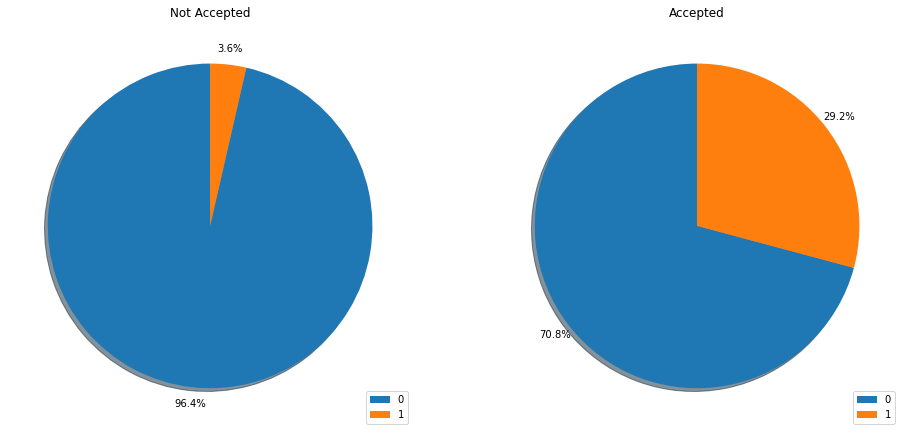

In [920]:
plot_pie('CD Account')

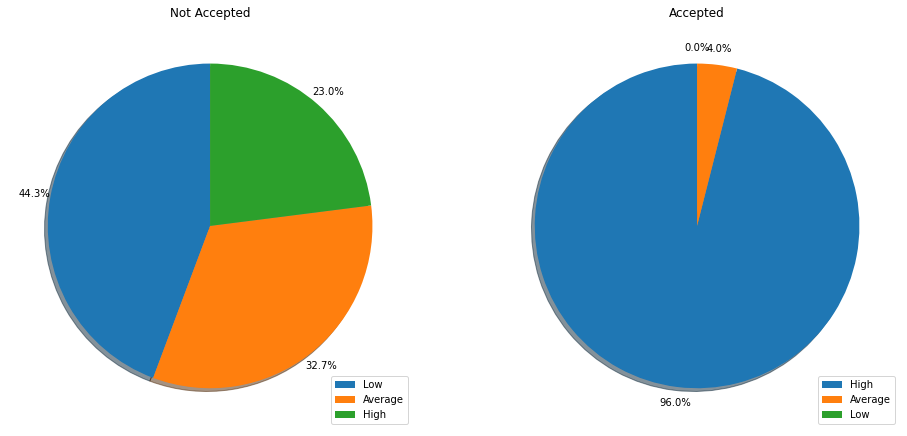

In [921]:
plot_pie('Income_grp')

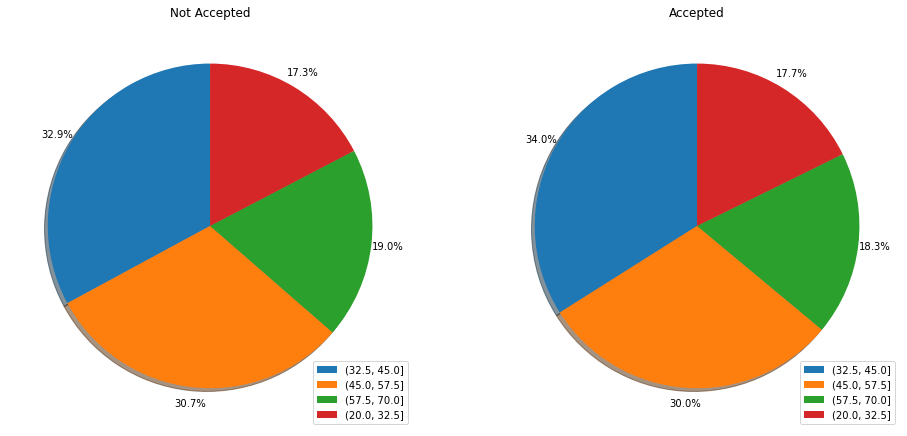

In [922]:
plot_pie('Age_grp')

In [923]:
def plot_bivariate(variable_1,variable_2):
    
    plt.figure(figsize=(24,5))
    plt.subplot(1,2,1)
    plt.title('Accepted')
    sns.countplot(x=variable_1,hue=variable_2,data=df_accept)
    plt.xticks(rotation=90)

    plt.subplot(1,2,2)    
    plt.title('Not Accepted')
    sns.countplot(x=variable_1,hue=variable_2,data=df_Naccept)
    plt.xticks(rotation=90)

    plt.show()

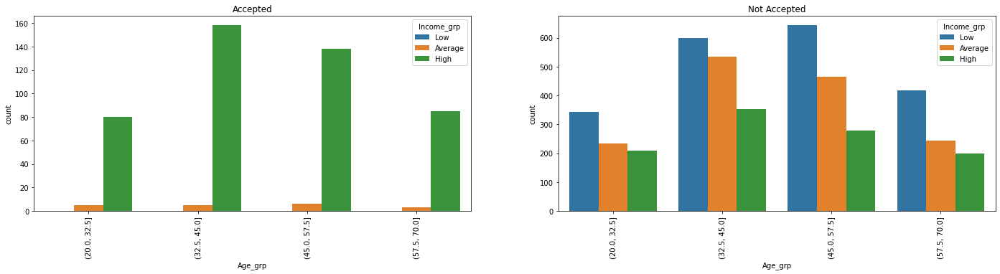

In [924]:
plot_bivariate('Age_grp','Income_grp')

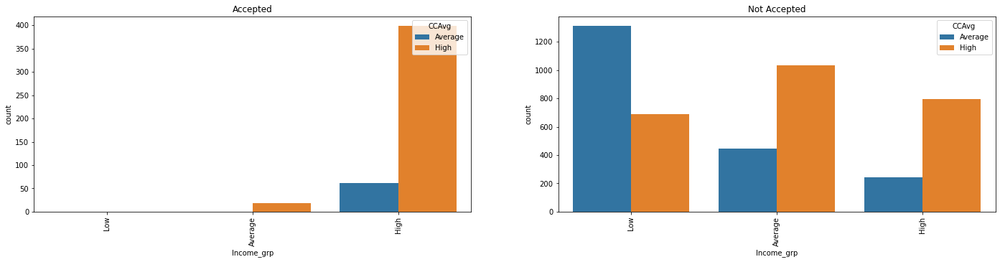

In [925]:
plot_bivariate('Income_grp','CCAvg')

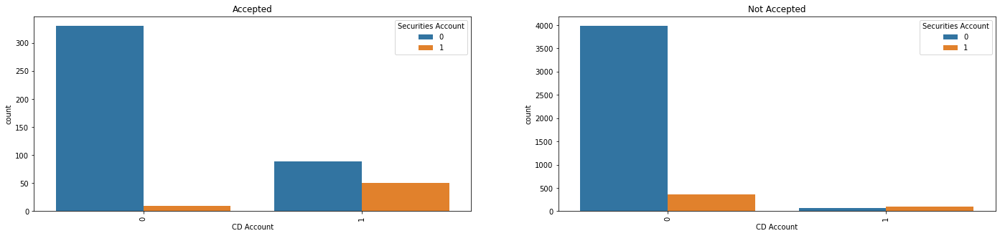

In [926]:
plot_bivariate('CD Account','Securities Account')

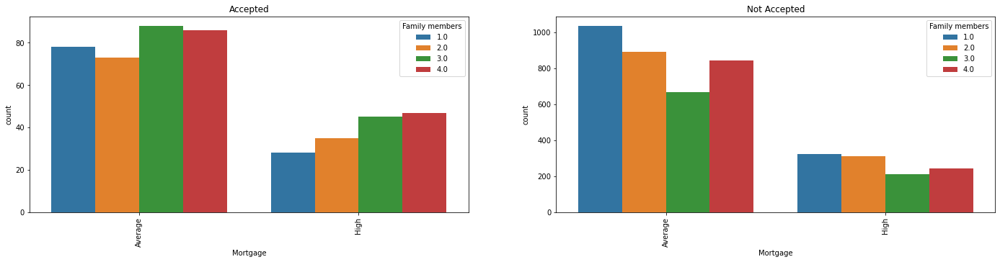

In [927]:
plot_bivariate('Mortgage','Family members')

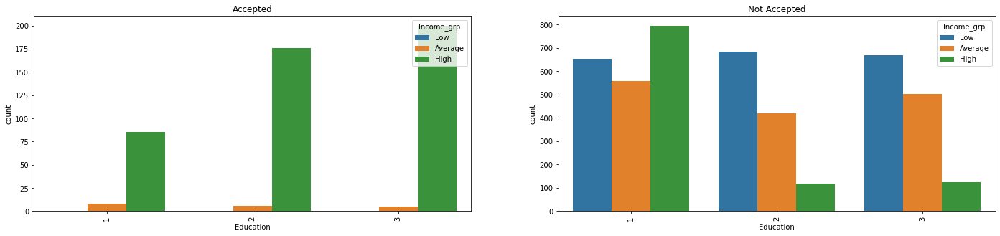

In [928]:
plot_bivariate('Education','Income_grp')

## Encoding of categorical values

In [929]:
dummy = pd.get_dummies(df[['Income_grp','Age_grp','Exp_grp','Mortgage','CCAvg']], drop_first=True)
# Add the results to the master dataframe
df_final_dum = pd.concat([df, dummy], axis=1)
df_final_dum

,ID,Age (in years),Experience (in years),Income (in K/month),ZIP Code,Family members,CCAvg,Education,Mortgage,Personal Loan,Securities Account,CD Account,Online,CreditCard,Age_grp,Income_grp,Exp_grp,Income_grp_Average,Income_grp_High,"Age_grp_(32.5, 45.0]","Age_grp_(45.0, 57.5]","Age_grp_(57.5, 70.0]","Exp_grp_(2.368, 4.737]","Exp_grp_(4.737, 7.105]","Exp_grp_(7.105, 9.474]","Exp_grp_(9.474, 11.842]","Exp_grp_(11.842, 14.211]","Exp_grp_(14.211, 16.579]","Exp_grp_(16.579, 18.947]","Exp_grp_(18.947, 21.316]","Exp_grp_(21.316, 23.684]","Exp_grp_(23.684, 26.053]","Exp_grp_(26.053, 28.421]","Exp_grp_(28.421, 30.789]","Exp_grp_(30.789, 33.158]","Exp_grp_(33.158, 35.526]","Exp_grp_(35.526, 37.895]","Exp_grp_(37.895, 40.263]","Exp_grp_(40.263, 42.632]","Exp_grp_(42.632, 45.0]",Mortgage_High,CCAvg_High
0,1,25.0,1.0000,49,91107,4.0,High,1,Average,0,1,0,0,0,"(20.0, 32.5]",Low,"(0.0, 2.368]",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,2,45.0,19.0000,34,90089,3.0,High,1,Average,0,1,0,0,0,"(32.5, 45.0]",Low,"(18.947, 21.316]",0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
2,3,39.0,15.0000,11,94720,1.0,Average,1,Average,0,0,0,0,0,"(32.5, 45.0]",Low,"(14.211, 16.579]",0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,4,35.0,9.0000,100,94112,1.0,High,2,Average,0,0,0,0,0,"(32.5, 45.0]",High,"(7.105, 9.474]",0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,5,35.0,8.0000,45,91330,4.0,Average,2,Average,0,0,0,0,1,"(32.5, 45.0]",Low,"(7.105, 9.474]",0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,6,37.0,13.0000,29,92121,4.0,Average,2,High,0,0,0,1,0,"(32.5, 45.0]",Low,"(11.842, 14.211]",0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
6,7,53.0,27.0000,72,91711,2.0,High,2,Average,0,0,0,1,0,"(45.0, 57.5]",Average,"(26.053, 28.421]",1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
7,8,50.0,24.0000,22,93943,1.0,Average,3,Average,0,0,0,0,1,"(45.0, 57.5]",Low,"(23.684, 26.053]",0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
8,9,35.0,10.0000,81,90089,3.0,Average,2,High,0,0,0,1,0,"(32.5, 45.0]",Average,"(9.474, 11.842]",1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
9,10,34.0,9.0000,180,93023,1.0,High,3,Average,1,0,0,0,0,"(32.5, 45.0]",High,"(7.105, 9.474]",0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


## Dropping not required columns

In [930]:
df_final_dum = df_final_dum.drop(['CCAvg', 'Mortgage', 'Income_grp', 'Age_grp', 'Exp_grp', 'ZIP Code','Experience (in years)','Age (in years)'], 1)
df_final_dum

,ID,Income (in K/month),Family members,Education,Personal Loan,Securities Account,CD Account,Online,CreditCard,Income_grp_Average,Income_grp_High,"Age_grp_(32.5, 45.0]","Age_grp_(45.0, 57.5]","Age_grp_(57.5, 70.0]","Exp_grp_(2.368, 4.737]","Exp_grp_(4.737, 7.105]","Exp_grp_(7.105, 9.474]","Exp_grp_(9.474, 11.842]","Exp_grp_(11.842, 14.211]","Exp_grp_(14.211, 16.579]","Exp_grp_(16.579, 18.947]","Exp_grp_(18.947, 21.316]","Exp_grp_(21.316, 23.684]","Exp_grp_(23.684, 26.053]","Exp_grp_(26.053, 28.421]","Exp_grp_(28.421, 30.789]","Exp_grp_(30.789, 33.158]","Exp_grp_(33.158, 35.526]","Exp_grp_(35.526, 37.895]","Exp_grp_(37.895, 40.263]","Exp_grp_(40.263, 42.632]","Exp_grp_(42.632, 45.0]",Mortgage_High,CCAvg_High
0,1,49,4.0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,2,34,3.0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
2,3,11,1.0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,4,100,1.0,2,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,5,45,4.0,2,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,6,29,4.0,2,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
6,7,72,2.0,2,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
7,8,22,1.0,3,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
8,9,81,3.0,2,0,0,0,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
9,10,180,1.0,3,1,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


## Train test split and standardisation

In [931]:
from sklearn.model_selection import train_test_split


In [932]:
df_train, df_test = train_test_split(df_final_dum, test_size=0.2, random_state=42, stratify=df_final_dum['Personal Loan'])

In [933]:
df_train['Personal Loan'].value_counts(normalize=True)

0    0.904
1    0.096
Name: Personal Loan, dtype: float64

In [934]:
df_test['Personal Loan'].value_counts(normalize=True)

0    0.904
1    0.096
Name: Personal Loan, dtype: float64

In [935]:
from sklearn.preprocessing import MinMaxScaler

In [936]:
scaler = MinMaxScaler()
df_train[['Income (in K/month)', 'Family members']].describe()

,Income (in K/month),Family members
count,4000.000000,4000.000000
mean,73.479750,2.381250
std,46.321345,1.147923
min,8.000000,1.000000
25%,38.000000,1.000000
50%,63.000000,2.000000
75%,98.000000,3.000000
max,224.000000,4.000000


In [937]:
df_train[['Income (in K/month)', 'Family members']] = scaler.fit_transform(df_train[['Income (in K/month)', 'Family members']])
df_train[['Income (in K/month)', 'Family members']].describe()

<ipython-input-937-659ba3c7725f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train[['Income (in K/month)', 'Family members']] = scaler.fit_transform(df_train[['Income (in K/month)', 'Family members']])
C:\Users\AVTJUV744\Anaconda3\lib\site-packages\pandas\core\indexing.py:1738: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value[:, i].tolist(), pi)


,Income (in K/month),Family members
count,4000.000000,4000.000000
mean,0.303147,0.460417
std,0.214451,0.382641
min,0.000000,0.000000
25%,0.138889,0.000000
50%,0.254630,0.333333
75%,0.416667,0.666667
max,1.000000,1.000000


In [938]:
df_test[['Income (in K/month)', 'Family members']] = scaler.transform(df_test[['Income (in K/month)', 'Family members']])
df_test[['Income (in K/month)', 'Family members']].describe()

<ipython-input-938-a8e223920a32>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test[['Income (in K/month)', 'Family members']] = scaler.transform(df_test[['Income (in K/month)', 'Family members']])
C:\Users\AVTJUV744\Anaconda3\lib\site-packages\pandas\core\indexing.py:1738: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value[:, i].tolist(), pi)


,Income (in K/month),Family members
count,1000.000000,1000.000000
mean,0.309963,0.484667
std,0.207723,0.377884
min,0.000000,0.000000
25%,0.152778,0.000000
50%,0.263889,0.333333
75%,0.430556,1.000000
max,0.912037,1.000000


## Sampling as the data is imbalanced

In [939]:
X_train = df_train.drop('Personal Loan', axis=1)
y_train = df_train['Personal Loan']
X_test = df_test.drop('Personal Loan', axis=1)
y_test = df_test['Personal Loan']


In [940]:
# Import the SMOTE package
from imblearn.over_sampling import SMOTE
# Synthesize minority class datapoints using SMOTE
sm = SMOTE(random_state=42, sampling_strategy='minority')
smote_x_train, smote_y_train = sm.fit_resample(X_train, y_train)
# Separate into training and test sets
X_train = pd.DataFrame(smote_x_train, columns = X_train.columns)
y_train = pd.DataFrame(smote_y_train, columns = ['Personal Loan'])


## Model building and evaluation

### Logistic regression 

In [941]:
from sklearn.linear_model import LogisticRegression

In [942]:
logreg = LogisticRegression(random_state=42)
logreg.fit(X_train, y_train)

C:\Users\AVTJUV744\Anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\AVTJUV744\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=42)

In [943]:
y_train_pred = logreg.predict(X_train)

In [944]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [945]:
accuracy_score(y_train, y_train_pred)

0.9358407079646017

In [946]:
confusion_matrix(y_train, y_train_pred)

array([[3361,  255],
       [ 209, 3407]], dtype=int64)

In [947]:
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       0.94      0.93      0.94      3616
           1       0.93      0.94      0.94      3616

    accuracy                           0.94      7232
   macro avg       0.94      0.94      0.94      7232
weighted avg       0.94      0.94      0.94      7232



In [948]:
y_test_pred = logreg.predict(X_test)

In [949]:
accuracy_score(y_test, y_test_pred)

0.9

**The model is performing good on test data as well. Als othe precision, recall and accuracy is high.**

### Random Forest

In [950]:
from sklearn.ensemble import RandomForestClassifier

In [951]:
rf = RandomForestClassifier(random_state=42, n_estimators=50, oob_score=True)
rf.fit(X_train, y_train)
y_train_pred = rf.predict(X_train)

<ipython-input-951-a03724fdadca>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X_train, y_train)


In [952]:
accuracy_score(y_train, y_train_pred)

0.9998617256637168

In [953]:
y_test_pred = rf.predict(X_test)
accuracy_score(y_test, y_test_pred)

0.975

In [954]:
confusion_matrix(y_train, y_train_pred)

array([[3616,    0],
       [   1, 3615]], dtype=int64)

In [955]:
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3616
           1       1.00      1.00      1.00      3616

    accuracy                           1.00      7232
   macro avg       1.00      1.00      1.00      7232
weighted avg       1.00      1.00      1.00      7232



**The model is giving good accuracy on unseen data as well. Also the precision and recall is also good.**

In [956]:
from sklearn.tree import DecisionTreeClassifier

In [957]:
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_train_pred = rf.predict(X_train)

In [958]:
accuracy_score(y_train, y_train_pred)

0.9998617256637168

In [959]:
y_test_pred = rf.predict(X_test)
accuracy_score(y_test, y_test_pred)

0.975

In [960]:
confusion_matrix(y_train, y_train_pred)

array([[3616,    0],
       [   1, 3615]], dtype=int64)

In [961]:
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3616
           1       1.00      1.00      1.00      3616

    accuracy                           1.00      7232
   macro avg       1.00      1.00      1.00      7232
weighted avg       1.00      1.00      1.00      7232



**Here the result is same as random forest. Also the below steps are not required but still for learning purpose writing the code. Also we can do regularisation just to avoid overfitting if needed **

## Hyperparamaeter tuning and cross validation

In [962]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier


info_models =[]
best_estimators = {}
m_param = {
    
    'RandomForestClassifier' :  {
        'model'  :  RandomForestClassifier(),
        'params' : {
            'n_estimators':[5,10,15],
            'criterion': ['entropy','gini'],
            'random_state' : [5,10,20],
            'max_depth' : [3,4,5],
                    } 
            },
    
    'DecisionTreeCLassifier' :  {
        'model': DecisionTreeClassifier(),
        'params': {
            'criterion': ['gini','entropy'],
            'max_depth' : [3,4,5],
            'random_state' : [5,10,20],
                  }
          },
    
    'LogosticRegression' : {
         'model': LogisticRegression(),
        'params': {
            'C': [1,2,3,4,5,6,7],
            'multi_class' : ['auto', 'ovr' ]
                }
        },
        
        
}

In [ ]:
for m_name, mp in m_param.items():
    
    Gsearch = GridSearchCV(mp['model'], mp['params'], cv=3, return_train_score=False)
    print(mp['model'], mp['params'])
    for i in range(len(X_train)):
        Gsearch.fit(X_train[iter], y_train) 
        info_models.append({
              'model': m_name,
              'best_score_raw': Gsearch.best_score_,
              'best_params': str(Gsearch.best_params_)
            })
    best_estimators[m_name] = Gsearch.best_estimator_

In [ ]:
import pandas as pd    
model_details = pd.DataFrame(info_models,columns=['model','best_score','best_params'])
model_details = model_details.sort_values(by='best_score',ascending=False)
model_details.drop_duplicates(subset =['model','best_score','best_params'], keep = False)
model_details['best_params']

In [ ]:
from sklearn.model_selection import cross_val_score

final_list =[]
for key in best_estimators.keys():
    out = cross_val_score(best_estimators[key], X_test, Y_test, scoring='accuracy', cv = 10).mean()*100
    print(out)
    final_list.append(out)
         
model_details['Cross_val_score'] = final_list
model_details